<a href="https://colab.research.google.com/github/youwenwang/ywang4228-tpwd-oyster-dredge-data-analysis/blob/main/10242023_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Load Dataset

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
%cd drive/MyDrive/CS/wyw/research/Oyster/bay_wise

/content/drive/MyDrive/CS/wyw/research/Oyster/bay_wise


In [ ]:
!pip install sweetviz ydata-profiling autoviz

In [4]:
import os
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
import sweetviz as sv
from ydata_profiling import ProfileReport
from autoviz.AutoViz_Class import AutoViz_Class
import matplotlib.dates as mdates

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [5]:
%matplotlib inline

In [6]:
df = pd.read_parquet('data/oyster_expanded.parquet', engine='pyarrow')

In [ ]:
df.head()

,gear_stratum_code_text,major_area_code_text,minor_bay_code_text,station_code,Species_code,Species_code_text,shallow_depth,temp,DO,salinity,turbidity,number_sampled,length,stage,live_dead,spat,latitude,longitude,Date,Year,gear_size,length_code,user_def_header_field,HYDRO_ID
0,oyster dredge,SAN ANTONIO BAY,San Antonio Bay,54,9300.0,Eastern oyster,0.5,16.7,8.9,9.9,57.0,1,78.0,Harvest Size,1.0,0.0,28.381944,-96.744444,1986-01-02,1986,NaN,None,1,NaN
1,oyster dredge,SAN ANTONIO BAY,San Antonio Bay,54,9300.0,Eastern oyster,0.5,16.7,8.9,9.9,57.0,1,72.0,Juvenile,1.0,0.0,28.381944,-96.744444,1986-01-02,1986,NaN,None,1,NaN
2,oyster dredge,SAN ANTONIO BAY,San Antonio Bay,54,9300.0,Eastern oyster,0.5,16.7,8.9,9.9,57.0,1,96.0,Harvest Size,1.0,0.0,28.381944,-96.744444,1986-01-02,1986,NaN,None,1,NaN
3,oyster dredge,SAN ANTONIO BAY,San Antonio Bay,54,9300.0,Eastern oyster,0.5,16.7,8.9,9.9,57.0,1,124.0,Harvest Size,1.0,0.0,28.381944,-96.744444,1986-01-02,1986,NaN,None,1,NaN
4,oyster dredge,SAN ANTONIO BAY,San Antonio Bay,54,9300.0,Eastern oyster,0.5,16.7,8.9,9.9,57.0,1,80.0,Harvest Size,1.0,0.0,28.381944,-96.744444,1986-01-02,1986,NaN,None,1,NaN


In [ ]:
df.columns

Index(['gear_stratum_code_text', 'major_area_code_text', 'minor_bay_code_text',
       'station_code', 'Species_code', 'Species_code_text', 'shallow_depth',
       'temp', 'DO', 'salinity', 'turbidity', 'number_sampled', 'length',
       'stage', 'live_dead', 'spat', 'latitude', 'longitude', 'Date', 'Year',
       'gear_size', 'length_code', 'user_def_header_field', 'HYDRO_ID'],
      dtype='object')

# 2. Define EDA Workflow

In [19]:
def preprocess_and_save_data(df):
    df.rename(columns={'user_def_header_field': 'habitat'}, inplace=True)

    columns_to_drop = ['gear_stratum_code_text', 'minor_bay_code_text', 'station_code',
                       'Species_code', 'Species_code_text', 'number_sampled', 'gear_size']
    df.drop(columns=columns_to_drop, errors='ignore', inplace=True)

    for bay in df['major_area_code_text'].unique():
        bay_data = df[df['major_area_code_text'] == bay]
        bay_data.to_csv(f'./data/major_bay/{bay}.csv', index=False)

def display_dataset_info(bay_data):
    print(f"Shape of the dataset: {bay_data.shape}")
    missing_values = bay_data.isnull().mean() * 100
    print("Percentage of missing values column-wise:")
    print(missing_values)

def ydata_profile(bay_data, bay_name):
    start_time = time.time()
    profile = ProfileReport(bay_data, title=f"{bay_name} ydata Profile Report")
    profile.to_file(f"{bay_name}_ydata_report.html")
    print(f'ydata Profile for {bay_name} executed in {(time.time() - start_time)/60} minutes.')

def sweetviz_target_analysis(bay_data, bay_name, target_column='live_dead'):
    start_time = time.time()

    bay_data = bay_data.dropna(subset=[target_column])
    bay_data = bay_data[~bay_data['live_dead'].isin([0, 3])]
    bay_data[target_column] = bay_data[target_column].map({1: 1, 2: 0})

    warnings.filterwarnings('ignore', category=FutureWarning)
    report = sv.analyze(bay_data, target_feat=target_column)
    report.show_html(f'{bay_name}_target_analysis_report_{target_column}.html')

    print(f'Sweetviz target analysis executed in {(time.time() - start_time)/60} minutes.')

def autoviz_analysis(bay_data, bay_name, target_column):
    start_time = time.time()
    AV = AutoViz_Class()
    bay_data['Date'] = pd.to_datetime(bay_data['Date'])

    output_directory = f"./AutoVizPlots/{bay_name}"
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    # Execute AutoViz
    dft = AV.AutoViz(
        filename="",  # If AutoViz supports file saving, you might specify filename here
        sep=",",
        depVar=target_column,
        dfte=bay_data,
        header=0,
        verbose=1,
        lowess=False,
        chart_format="png",
        max_rows_analyzed=15000000,
        max_cols_analyzed=50,
        save_plot_dir=output_directory
    )
    print(f'AutoViz executed in {(time.time() - start_time)/60} minutes.')


def plot_monthly_averages(bay_data, bay_name):
    bay_data['Date'] = pd.to_datetime(bay_data['Date'])
    bay_data = bay_data[~bay_data['live_dead'].isin([0, 3])]
    bay_data['live_dead'] = bay_data['live_dead'].map({1: 1, 2: 0})

    monthly_df = bay_data.groupby(bay_data['Date'].dt.month).mean()

    plt.figure(figsize=(20, 5))

    variables = ['length', 'spat', 'turbidity', 'live_dead']
    titles = ['Length', 'Spat', 'Turbidity', 'Survival Rate']

    for i, (var, title) in enumerate(zip(variables, titles), 1):
        ax = plt.subplot(1, 4, i)
        ax.plot(monthly_df.index, monthly_df[var])
        ax.set_title(f'Monthly Average of {title}')
        ax.set_xlabel('Month')
        ax.set_ylabel(title)

        ax.axvspan(5, 10, alpha=0.2, color='cadetblue')

    plt.tight_layout()
    plt.show()

def plot_time_series_with_shades(bay_data, bay_name):
    bay_data['Date'] = pd.to_datetime(bay_data['Date'])
    bay_data = bay_data[~bay_data['live_dead'].isin([0, 3])]
    bay_data['live_dead'] = bay_data['live_dead'].map({1: 1, 2: 0})

    bay_data.set_index('Date', inplace=True)

    plt.figure(figsize=(25, 20))

    variables = ['length', 'spat', 'live_dead', 'turbidity', 'DO', 'salinity', 'temp', 'shallow_depth']
    titles = ['Length', 'Spat', 'Survival Rate', 'Turbidity', 'DO', 'Salinity', 'Temperature', 'Shallow Depth']

    for i, (var, title) in enumerate(zip(variables, titles), 1):
        ax = plt.subplot(8, 1, i)

        bay_data[var].resample('M').mean().plot(ax=ax)

        ax.set_title(f'Time Series of {title} ({bay_name})')
        ax.set_xlabel('Date')
        ax.set_ylabel(title)

        for year in range(bay_data.index.min().year, bay_data.index.max().year + 1):
            ax.axvspan(pd.to_datetime(f'{year}-05-01'), pd.to_datetime(f'{year}-10-31'), color='cadetblue', alpha=0.2)

        years = range(bay_data.index.min().year, bay_data.index.max().year + 1)
        ax.set_xticks([pd.to_datetime(f'{year}-05-01') for year in years])
        ax.set_xticklabels(years)

    plt.tight_layout()
    plt.show()

def main(bay_name):
    bay_data = pd.read_csv(f'./data/major_bay/{bay_name}.csv')

    print("*********************************************")
    print("Dataset Info:")
    display_dataset_info(bay_data)

    print("*********************************************")
    print("Starting ydata Profile...")
    ydata_profile(bay_data, bay_name)

    print("*********************************************")
    print("Starting Sweetviz Analysis...")
    sweetviz_target_analysis(bay_data, bay_name, 'live_dead')

    print("*********************************************")
    print("Starting AutoViz Analysis...")
    autoviz_analysis(bay_data, bay_name, 'live_dead')

    print("*********************************************")
    print("Starting Harvest Analysis...")
    plot_monthly_averages(bay_data, bay_name)
    plot_time_series_with_shades(bay_data, bay_name)

    print("*********************************************")
    print("Done!")


# 3. Bay-wise Analysis

In [ ]:
preprocess_and_save_data(df)

## 3.1 ARANSAS BAY

*********************************************
Dataset Info:
Shape of the dataset: (805190, 17)
Percentage of missing values column-wise:
major_area_code_text     0.000000
shallow_depth            0.127796
temp                     0.018132
DO                       0.133385
salinity                 0.018132
turbidity                0.212869
length                  85.662390
stage                   85.662390
live_dead                0.009439
spat                    91.234988
latitude                 0.000000
longitude                0.000000
Date                     0.000000
Year                     0.000000
length_code             97.537600
habitat                  0.000000
HYDRO_ID                91.969597
dtype: float64
*********************************************
Starting ydata Profile...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

ydata Profile for ARANSAS BAY executed in 1.0367011268933615 minutes.
*********************************************
Starting Sweetviz Analysis...


                                             |          | [  0%]   00:00 -> (? left)

Report ARANSAS BAY_target_analysis_report_live_dead.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
Sweetviz target analysis executed in 0.9619081735610961 minutes.
*********************************************
Starting AutoViz Analysis...
Shape of your Data Set loaded: (805190, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    16 Predictors classified...
        4 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['major_area_code_text', 'spat', 'length_code', 'HYDRO_ID']

################ Multi_Classification problem #####################
To fix data quality issues automatically, import FixD

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
shallow_depth,float64,0.112702,NA,0.300000,30.000000,"126 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 283 outliers greater than upper bound (3.20) or lower than lower bound(-0.00). Cap them or remove them."
temp,float64,0.015206,NA,4.200000,35.100000,"17 missing values. Impute them with mean, median, mode, or a constant value such as 123."
DO,float64,0.127014,NA,0.900000,22.500000,"142 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1223 outliers greater than upper bound (12.55) or lower than lower bound(2.55). Cap them or remove them."
salinity,float64,0.015206,NA,0.000000,42.000000,"17 missing values. Impute them with mean, median, mode, or a constant value such as 123."
turbidity,float64,0.193204,NA,1.000000,999.000000,"216 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 8957 outliers greater than upper bound (41.00) or lower than lower bound(-15.00). Cap them or remove them."
length,float64,11.069866,NA,3.000000,289.000000,"12376 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 469 outliers greater than upper bound (124.50) or lower than lower bound(0.50). Cap them or remove them."
stage,object,11.069866,0,nan,nan,"12376 missing values. Impute them with mean, median, mode, or a constant value such as 123., 1 rare categories: ['Spat']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
latitude,float64,0.000000,NA,26.145400,28.166111,has 20 outliers greater than upper bound (28.18) or lower than lower bound(28.04). Cap them or remove them.
longitude,float64,0.000000,NA,-97.205556,-96.821389,No issue
Date,datetime64[ns],0.000000,0,nan,nan,No issue


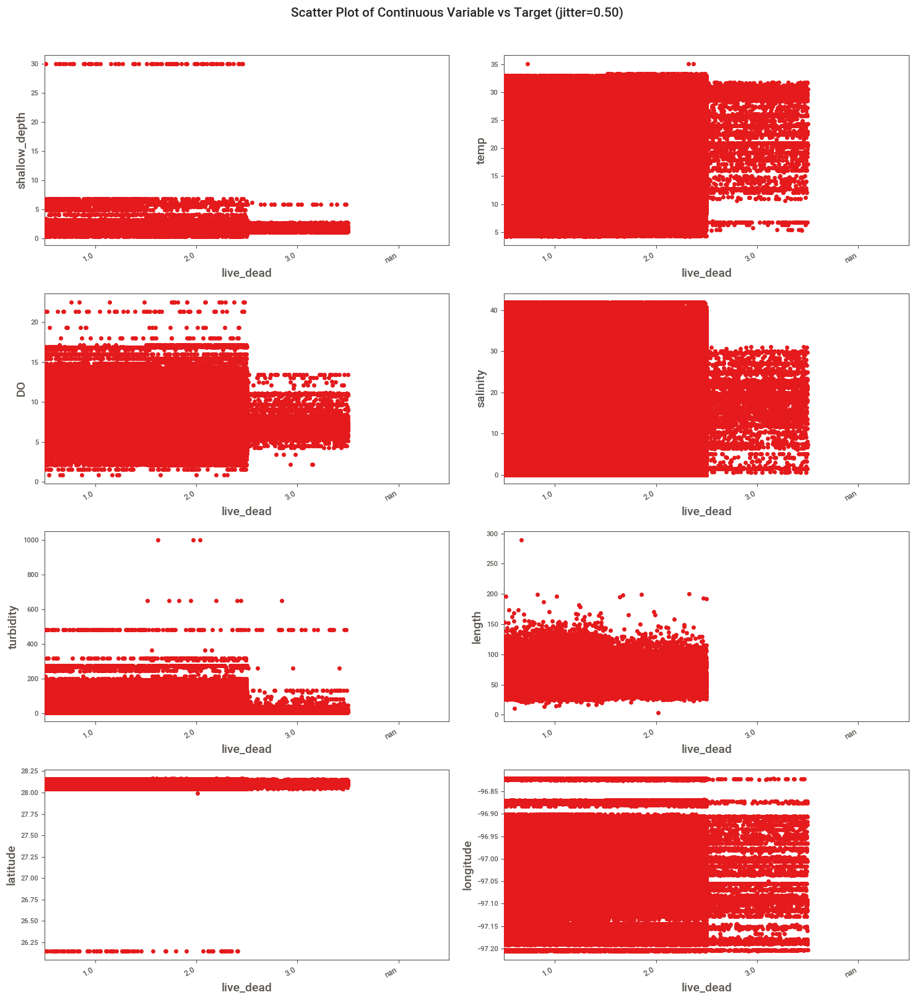

Total Number of Scatter Plots = 36


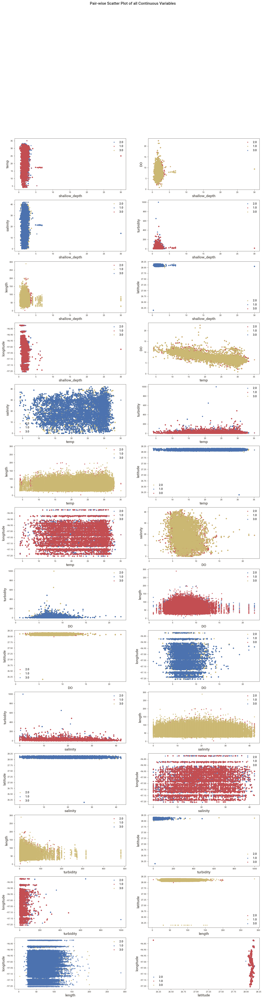

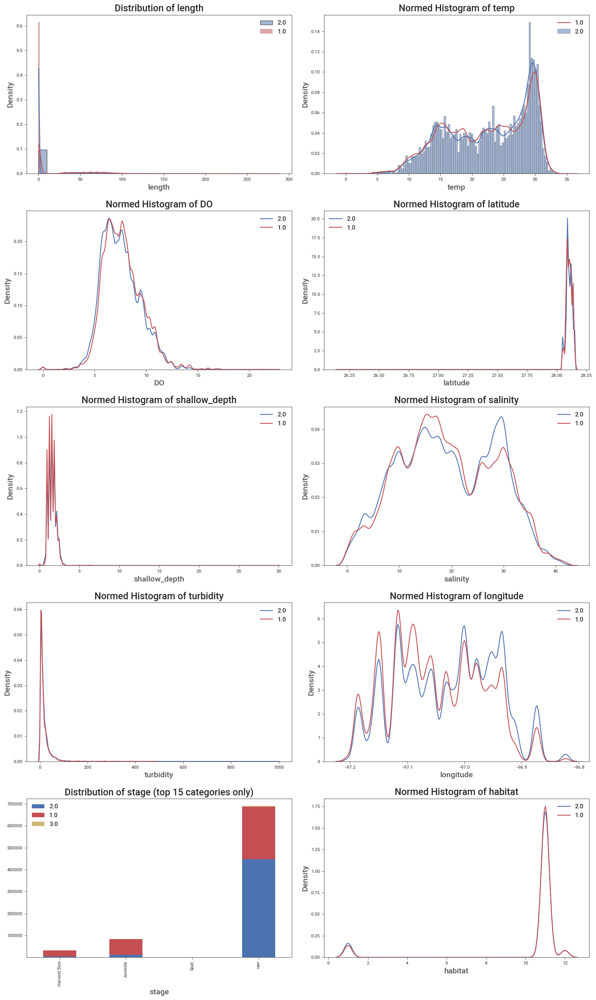

Could not draw some Distribution Plots


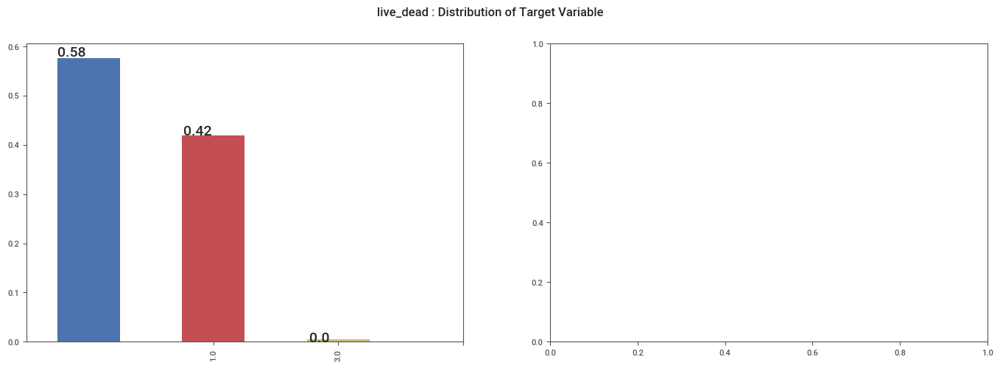

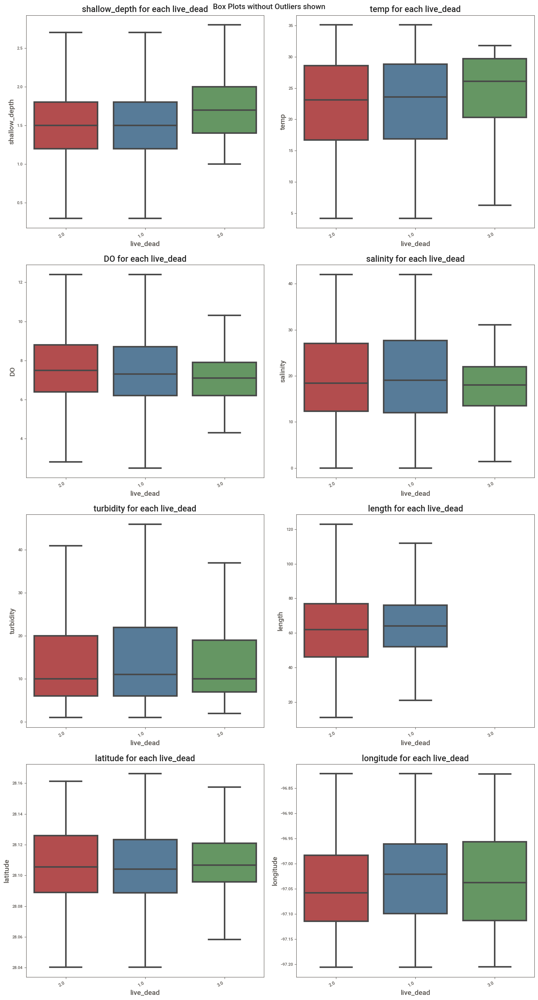

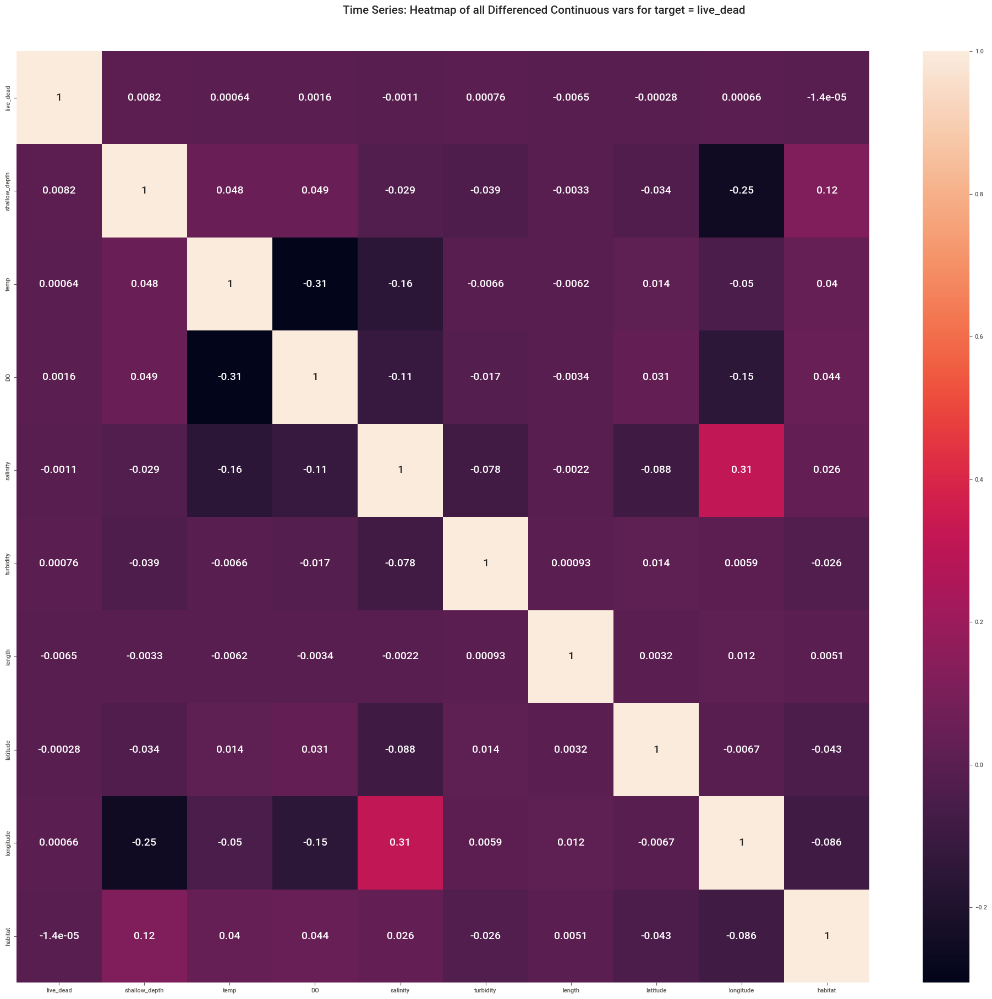

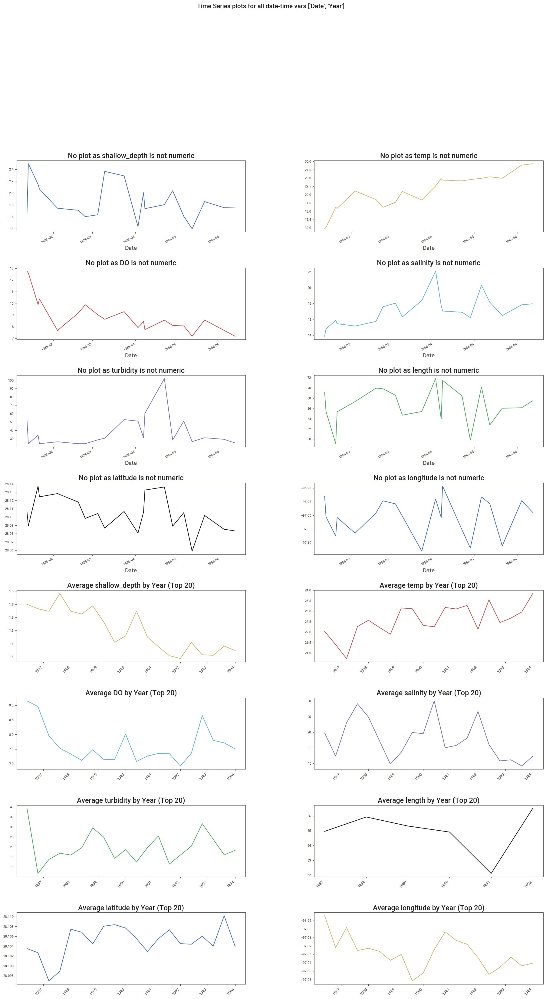

Could not draw some Time Series plots


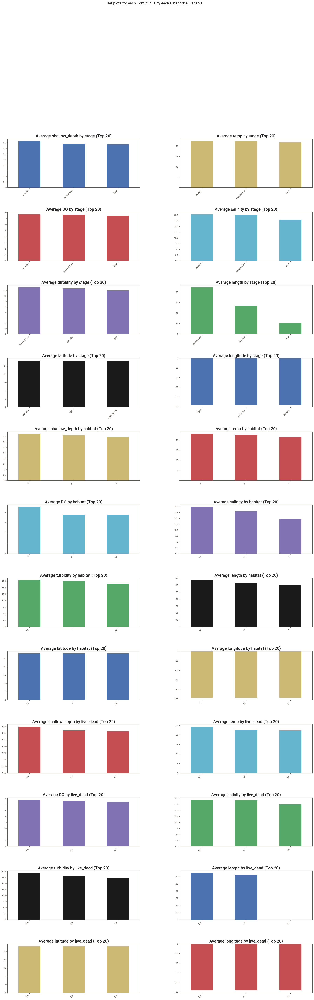

All Plots done
Time to run AutoViz = 298 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
AutoViz executed in 4.962470360596975 minutes.
*********************************************
Starting Harvest Analysis...


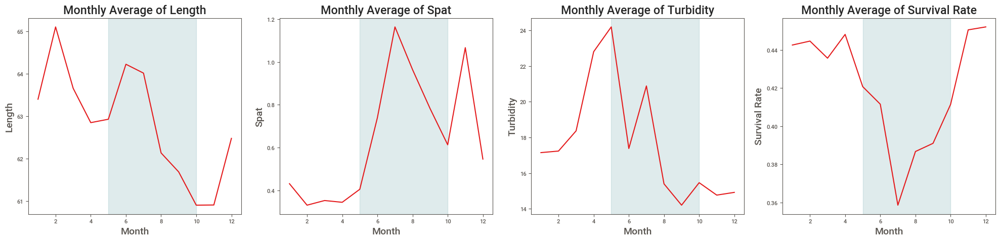

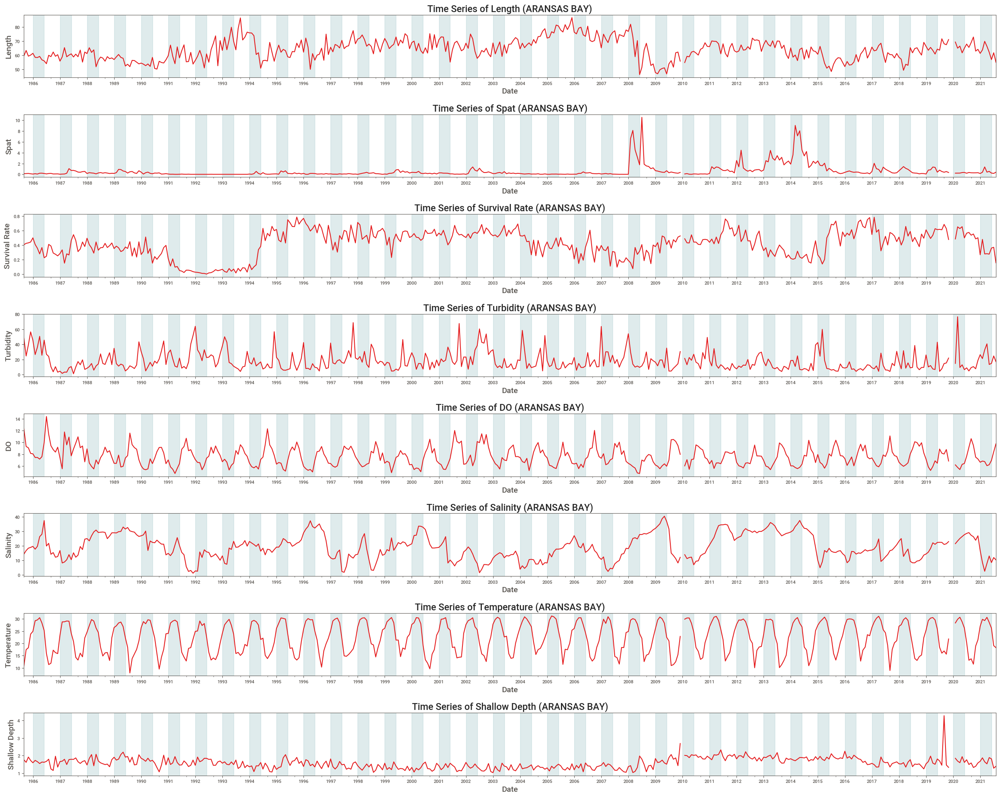

*********************************************
Done!


In [20]:
main('ARANSAS BAY')

## 3.2 SAN ANTONIO BAY

*********************************************
Dataset Info:
Shape of the dataset: (380882, 17)
Percentage of missing values column-wise:
major_area_code_text     0.000000
shallow_depth            0.127599
temp                     0.050147
DO                       0.057236
salinity                 0.061699
turbidity                0.096355
length                  80.678530
stage                   80.678530
live_dead                0.000263
spat                    84.479183
latitude                 0.000000
longitude                0.000000
Date                     0.000000
Year                     0.000000
length_code             96.989356
habitat                  0.000000
HYDRO_ID                89.325303
dtype: float64
*********************************************
Starting ydata Profile...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

ydata Profile for SAN ANTONIO BAY executed in 0.772235902150472 minutes.
*********************************************
Starting Sweetviz Analysis...


                                             |          | [  0%]   00:00 -> (? left)

Report SAN ANTONIO BAY_target_analysis_report_live_dead.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
Sweetviz target analysis executed in 0.5408491770426432 minutes.
*********************************************
Starting AutoViz Analysis...
Shape of your Data Set loaded: (380882, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    16 Predictors classified...
        2 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['major_area_code_text', 'length_code']

################ Multi_Classification problem #####################
To fix data quality issues automatically, import FixDQ from autoviz..

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
shallow_depth,float64,0.135438,NA,0.000000,23.000000,"118 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 984 outliers greater than upper bound (2.40) or lower than lower bound(0.00). Cap them or remove them."
temp,float64,0.022956,NA,4.000000,36.100000,"20 missing values. Impute them with mean, median, mode, or a constant value such as 123."
DO,float64,0.050502,NA,1.200000,20.300000,"44 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1569 outliers greater than upper bound (12.90) or lower than lower bound(2.50). Cap them or remove them."
salinity,float64,0.034433,NA,0.000000,42.600000,"30 missing values. Impute them with mean, median, mode, or a constant value such as 123."
turbidity,float64,0.084935,NA,0.000000,637.000000,"74 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 7500 outliers greater than upper bound (51.00) or lower than lower bound(-21.00). Cap them or remove them."
length,float64,21.558680,NA,5.000000,233.000000,"18783 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 450 outliers greater than upper bound (132.00) or lower than lower bound(-4.00). Cap them or remove them."
stage,object,21.558680,0,nan,nan,"18783 missing values. Impute them with mean, median, mode, or a constant value such as 123., 1 rare categories: ['Spat']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
spat,float64,53.838737,NA,0.000000,58.000000,"46907 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 9740 outliers greater than upper bound (0.00) or lower than lower bound(0.00). Cap them or remove them."
latitude,float64,0.000000,NA,28.166667,28.438600,has 4750 outliers greater than upper bound (28.42) or lower than lower bound(28.18). Cap them or remove them.
longitude,float64,0.000000,NA,-96.844444,-96.416600,has 8276 outliers greater than upper bound (-96.55) or lower than lower bound(-96.90). Cap them or remove them.


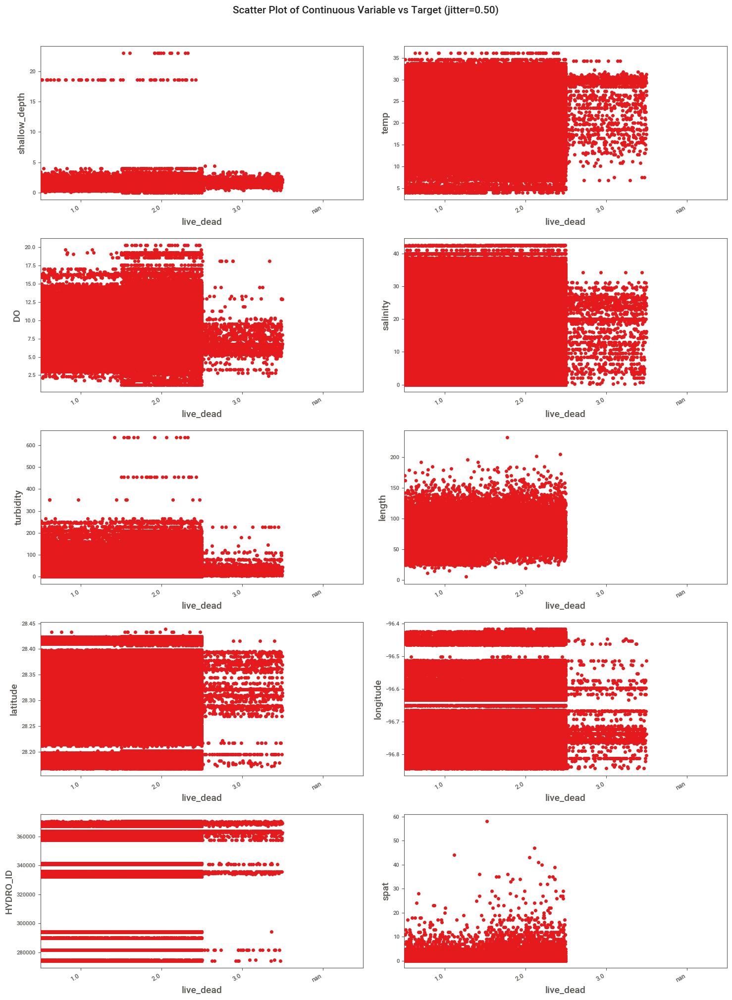

Total Number of Scatter Plots = 55


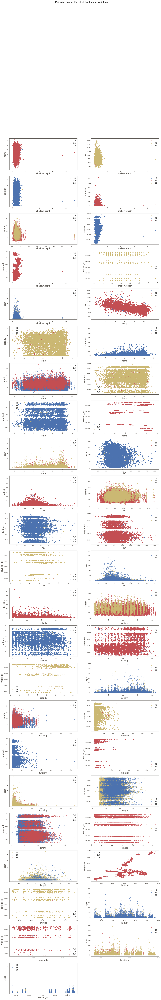

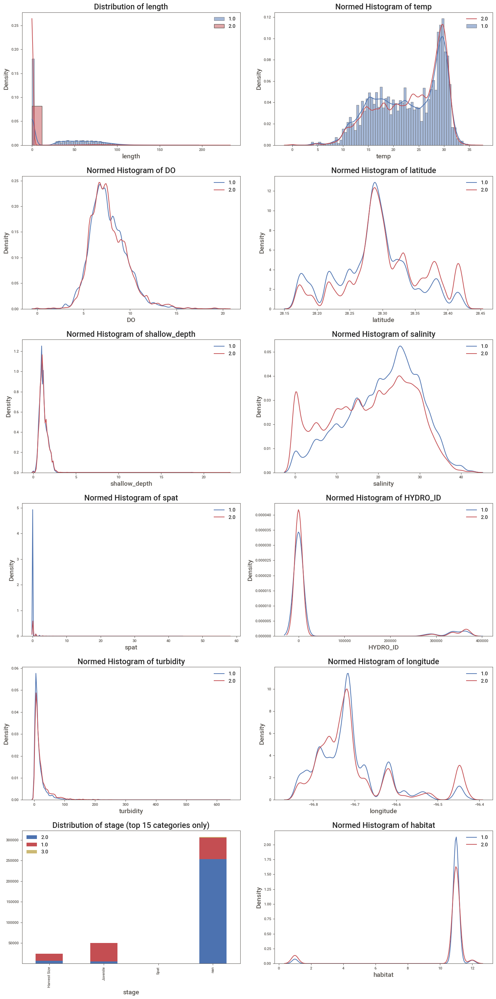

Could not draw some Distribution Plots


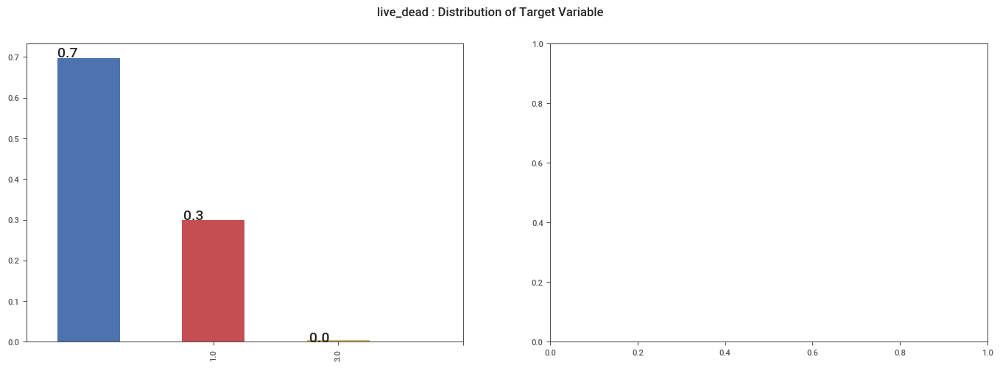

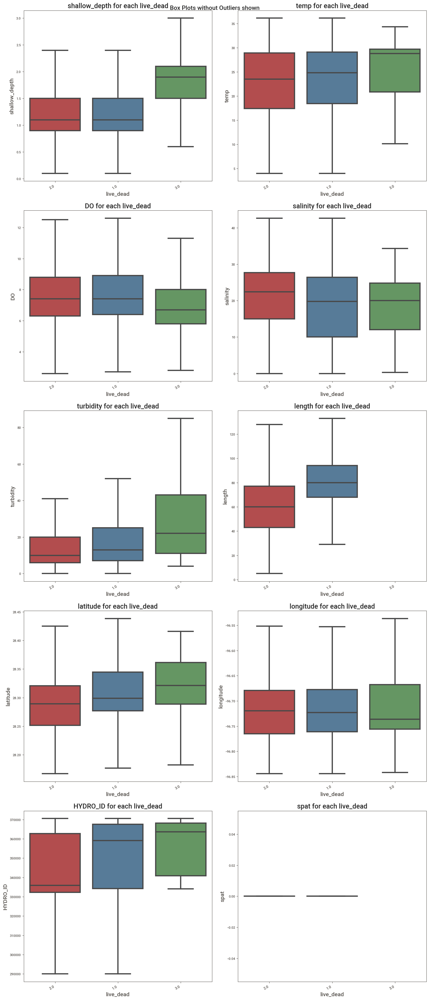

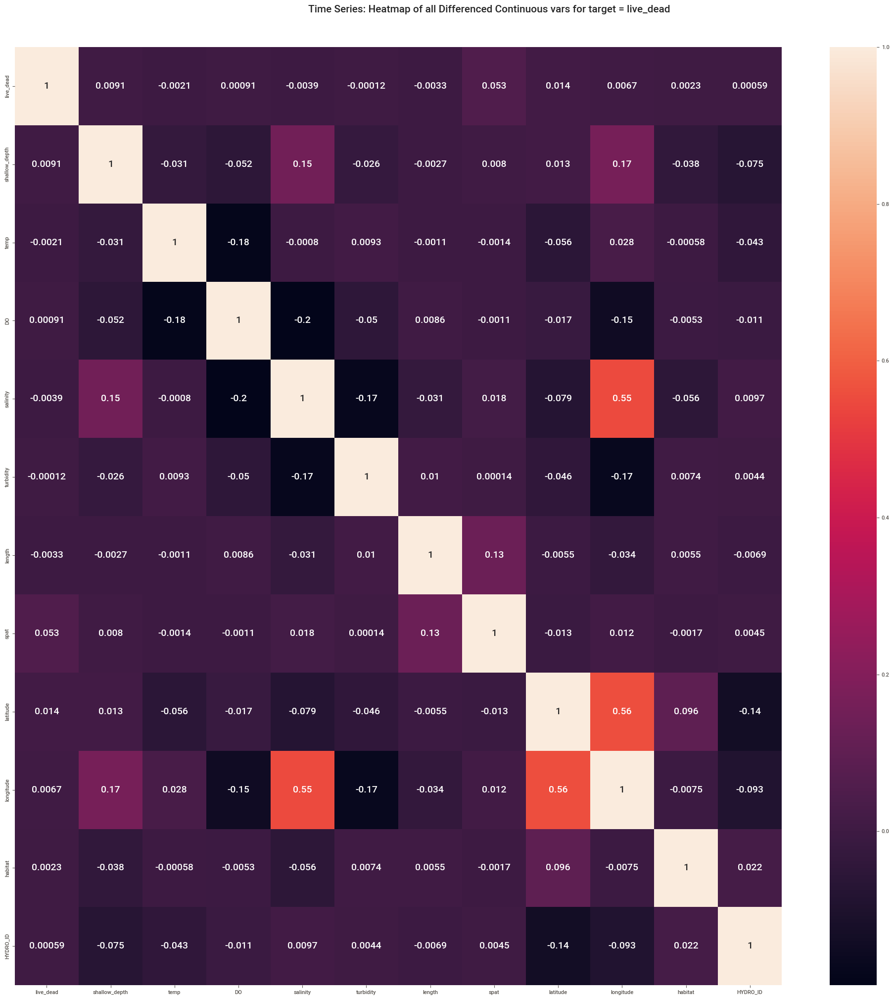

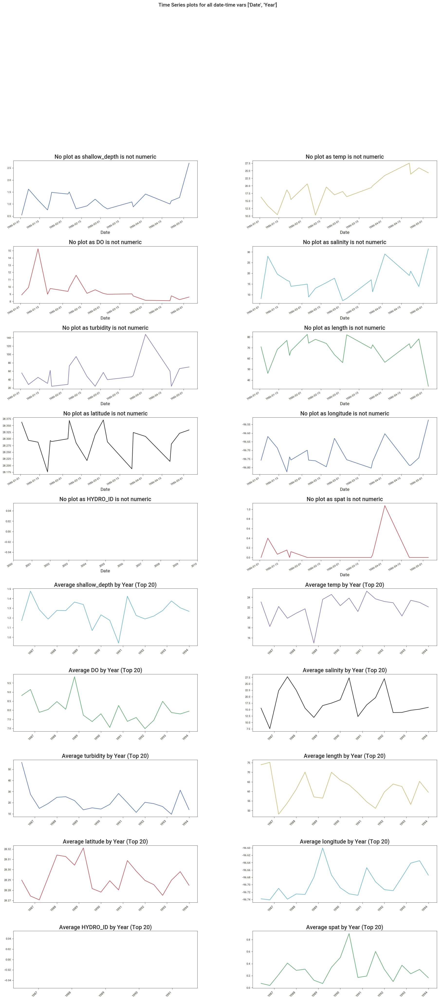

Could not draw some Time Series plots


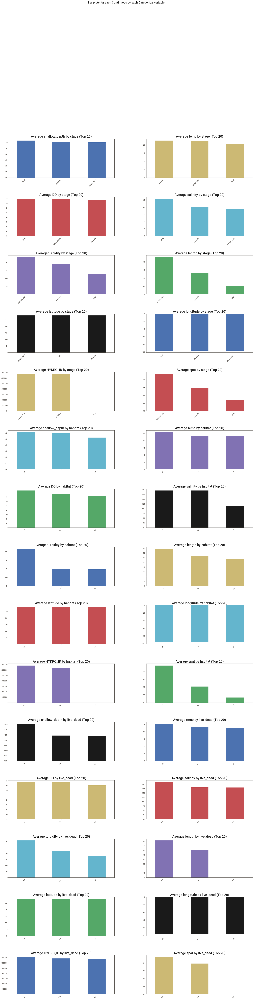

All Plots done
Time to run AutoViz = 252 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
AutoViz executed in 4.2076172153155005 minutes.
*********************************************
Starting Harvest Analysis...


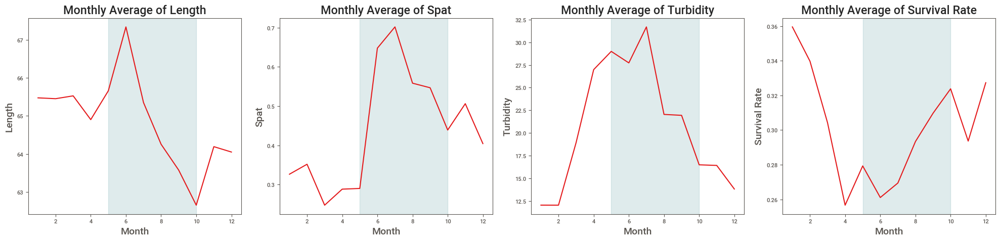

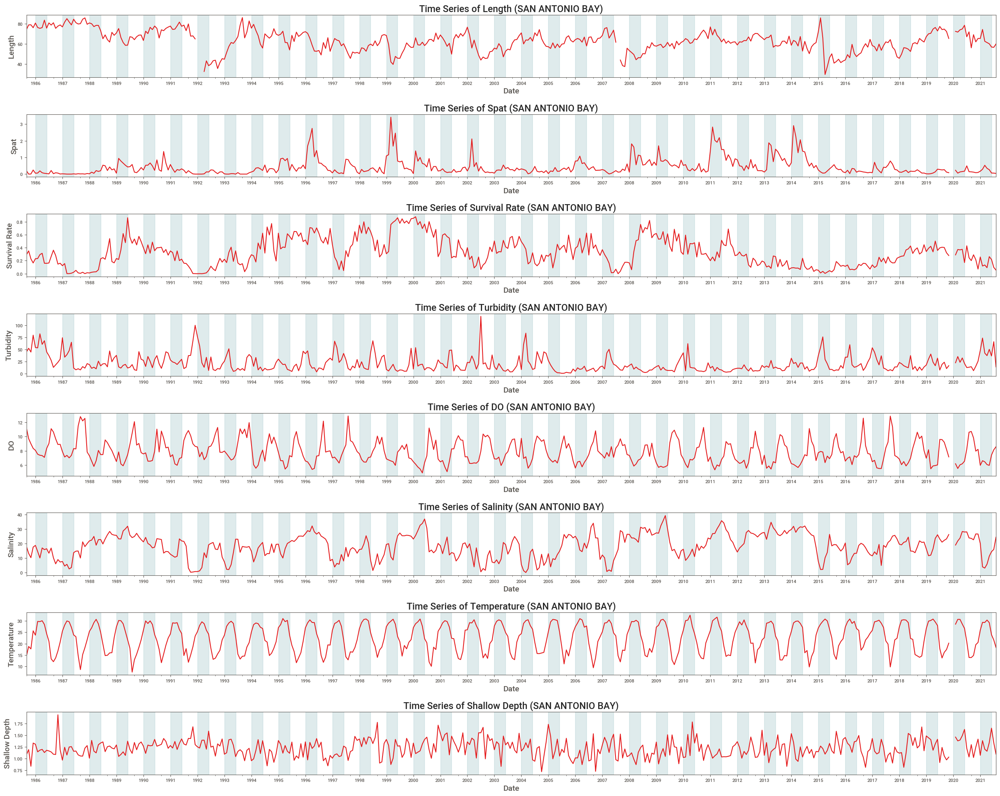

*********************************************
Done!


In [21]:
main('SAN ANTONIO BAY')

## 3.3 GALVESTON BAY

*********************************************
Dataset Info:
Shape of the dataset: (878001, 17)
Percentage of missing values column-wise:
major_area_code_text     0.000000
shallow_depth            0.085649
temp                     0.086105
DO                       0.701708
salinity                 0.264350
turbidity                0.723462
length                  82.958220
stage                   82.958220
live_dead                0.014465
spat                    88.331790
latitude                 0.000000
longitude                0.000000
Date                     0.000000
Year                     0.000000
length_code             98.857404
habitat                  0.000000
HYDRO_ID                94.809004
dtype: float64
*********************************************
Starting ydata Profile...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

ydata Profile for GALVESTON BAY executed in 1.0626221656799317 minutes.
*********************************************
Starting Sweetviz Analysis...


                                             |          | [  0%]   00:00 -> (? left)

Report GALVESTON BAY_target_analysis_report_live_dead.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
Sweetviz target analysis executed in 1.0466121315956116 minutes.
*********************************************
Starting AutoViz Analysis...
Shape of your Data Set loaded: (878001, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    16 Predictors classified...
        3 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['major_area_code_text', 'length_code', 'HYDRO_ID']

################ Multi_Classification problem #####################
To fix data quality issues automatically, import FixDQ from

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
shallow_depth,float64,0.049472,NA,0.000000,21.000000,"83 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1010 outliers greater than upper bound (4.40) or lower than lower bound(-0.40). Cap them or remove them."
temp,float64,0.104309,NA,2.100000,34.700000,"175 missing values. Impute them with mean, median, mode, or a constant value such as 123."
DO,float64,0.704536,NA,1.300000,27.100000,"1182 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 2229 outliers greater than upper bound (13.05) or lower than lower bound(2.25). Cap them or remove them."
salinity,float64,0.297431,NA,0.000000,41.600000,"499 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 302 outliers greater than upper bound (35.00) or lower than lower bound(-5.00). Cap them or remove them."
turbidity,float64,0.772486,NA,0.000000,999.000000,"1296 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 12561 outliers greater than upper bound (52.00) or lower than lower bound(-20.00). Cap them or remove them."
length,float64,17.240865,NA,6.000000,258.000000,"28925 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1173 outliers greater than upper bound (132.00) or lower than lower bound(-4.00). Cap them or remove them."
stage,object,17.240865,0,nan,nan,"28925 missing values. Impute them with mean, median, mode, or a constant value such as 123., 1 rare categories: ['Spat']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
spat,float64,58.954521,NA,0.000000,58.000000,"98908 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 8271 outliers greater than upper bound (0.00) or lower than lower bound(0.00). Cap them or remove them."
latitude,float64,0.000000,NA,29.033333,29.699444,has 23338 outliers greater than upper bound (29.66) or lower than lower bound(29.37). Cap them or remove them.
longitude,float64,0.000000,NA,-95.862700,-94.591667,has 5202 outliers greater than upper bound (-94.59) or lower than lower bound(-95.12). Cap them or remove them.


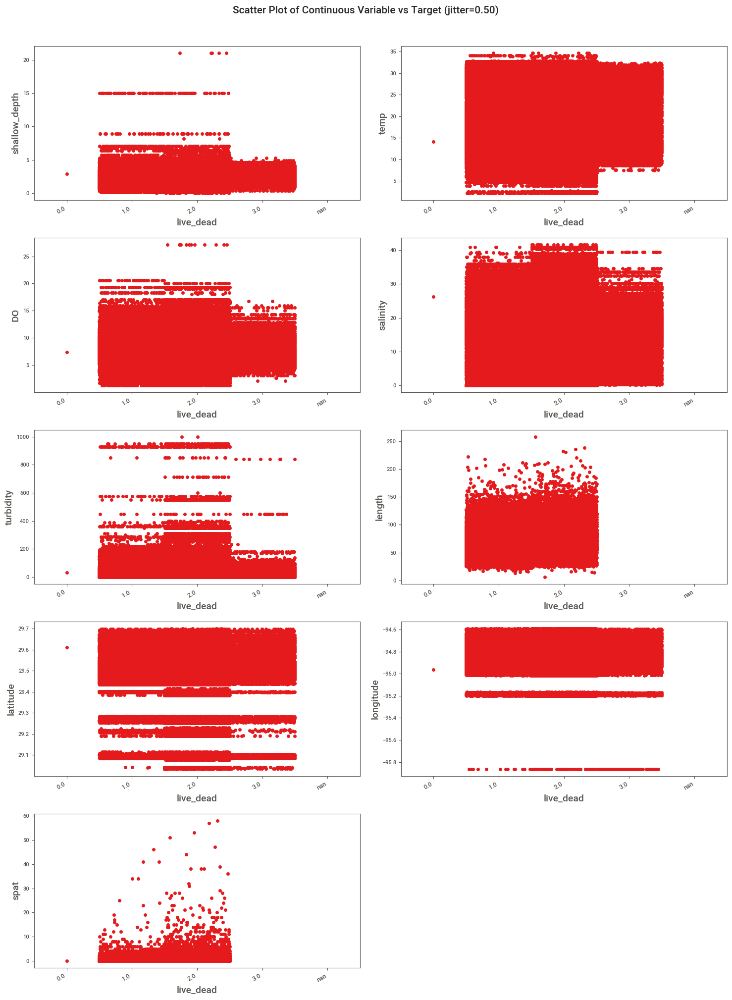

Total Number of Scatter Plots = 45


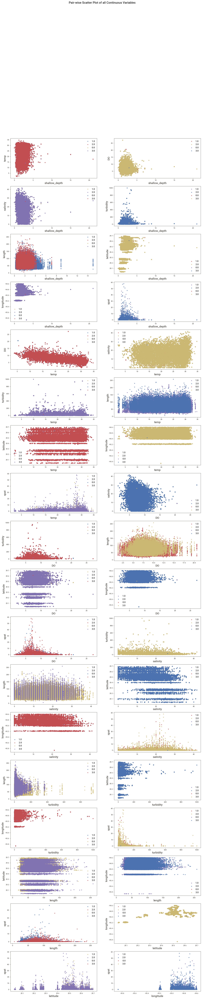

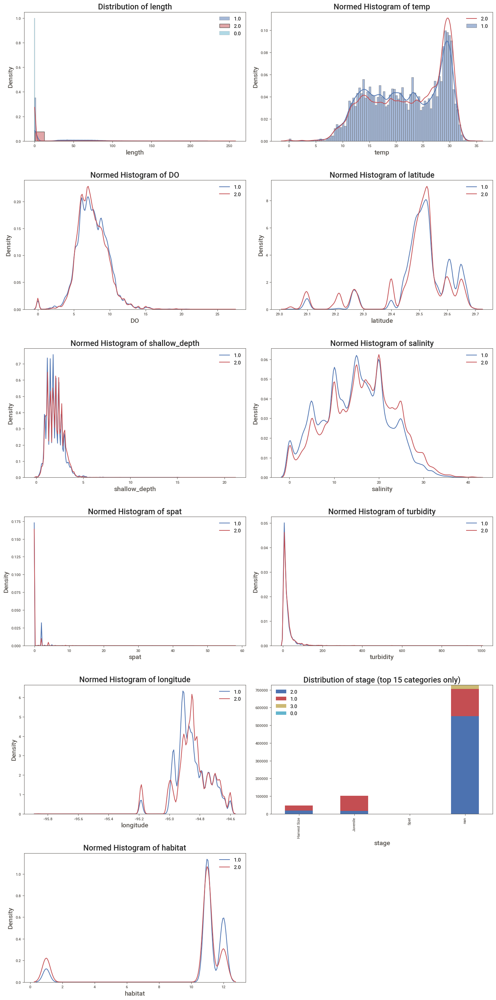

Could not draw some Distribution Plots


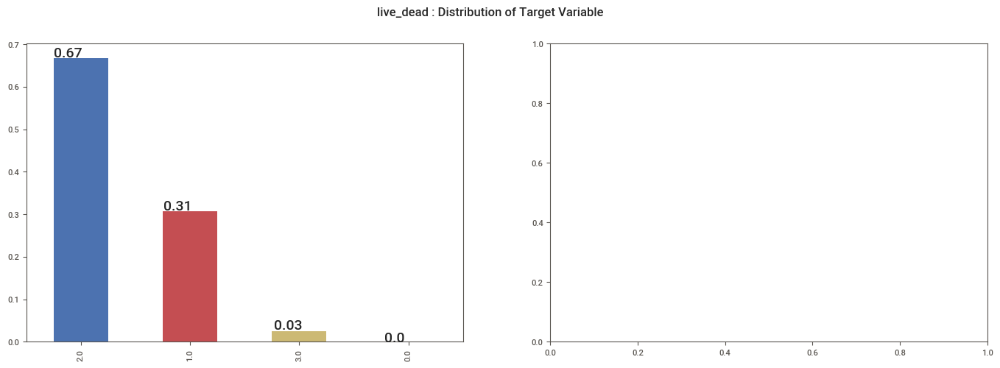

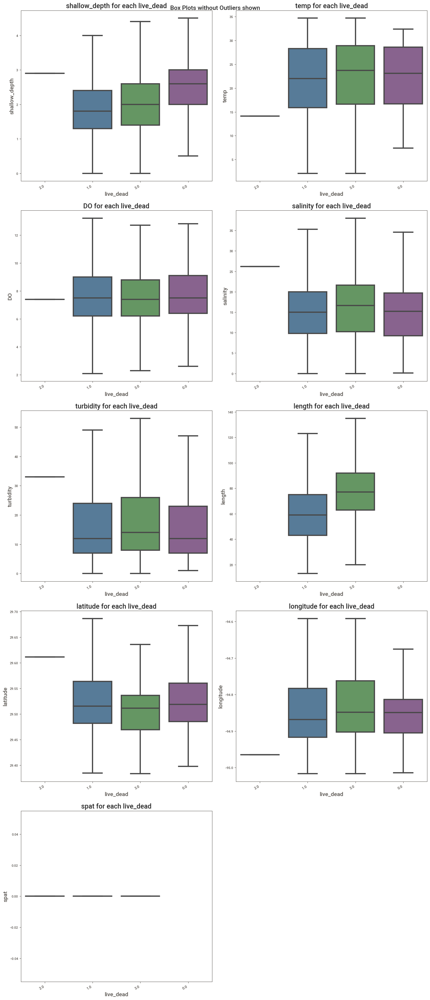

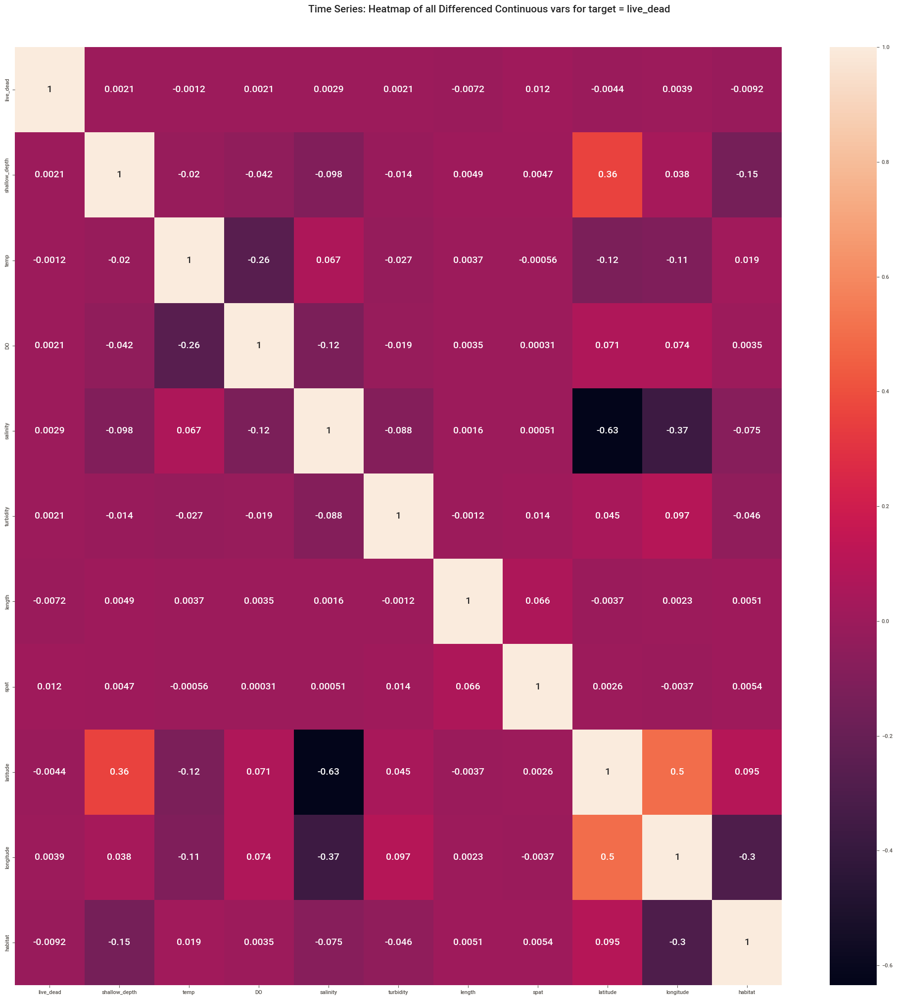

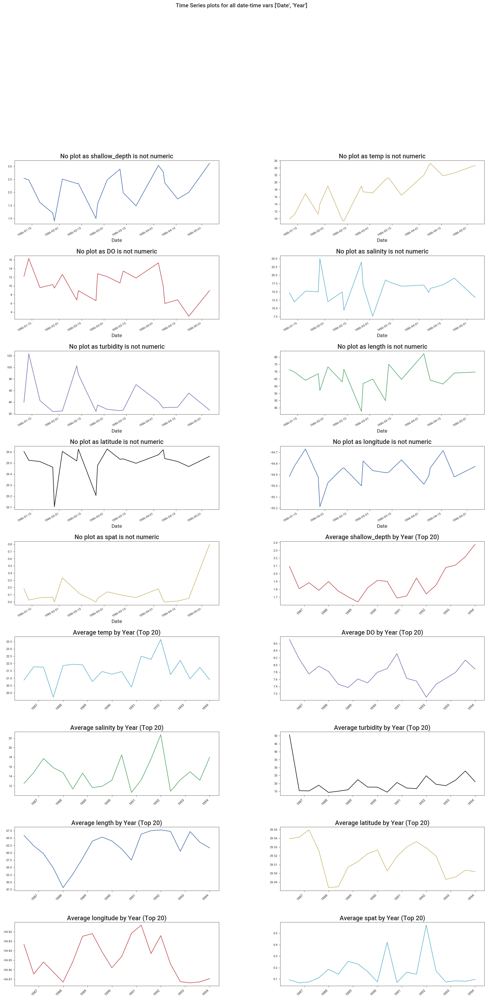

Could not draw some Time Series plots


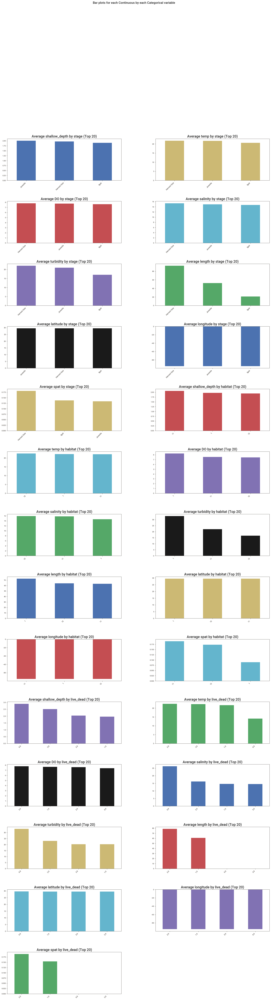

All Plots done
Time to run AutoViz = 354 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
AutoViz executed in 5.899994325637818 minutes.
*********************************************
Starting Harvest Analysis...


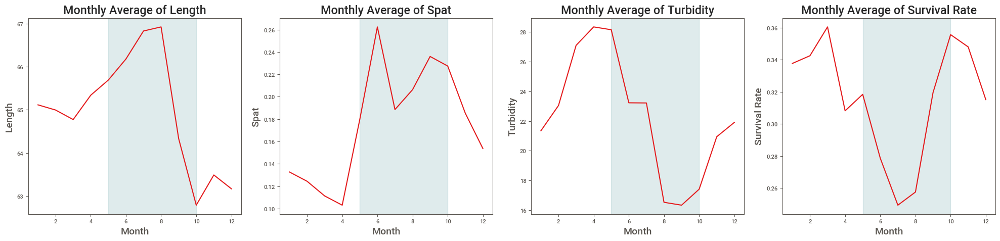

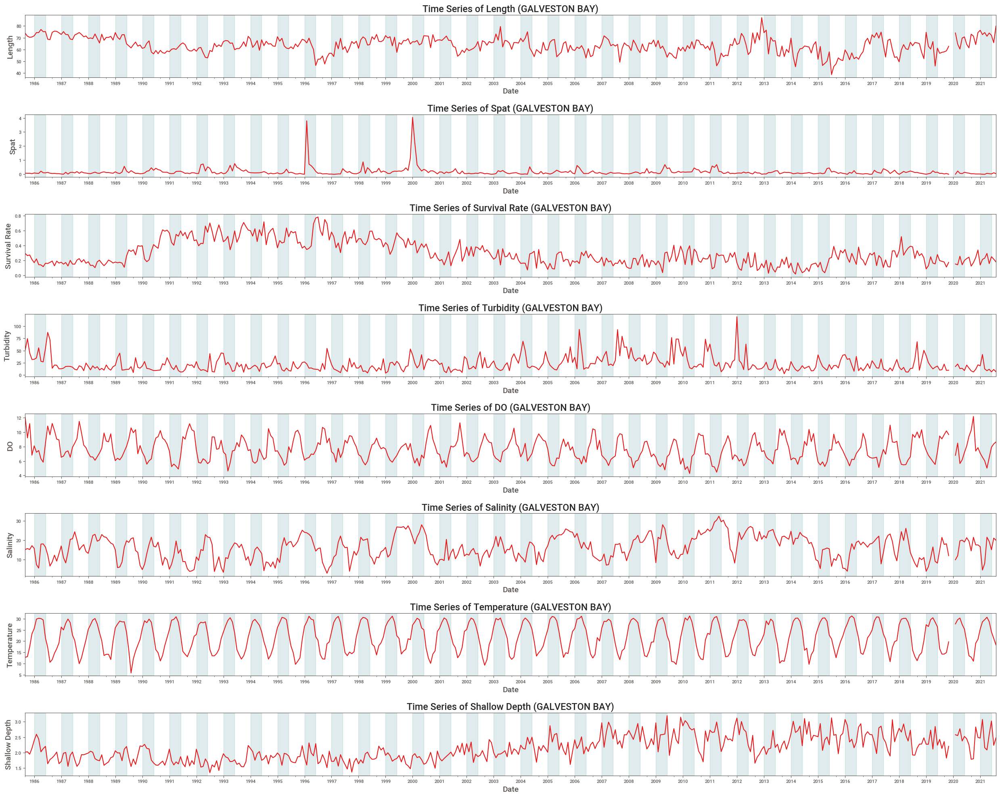

*********************************************
Done!


In [22]:
main('GALVESTON BAY')

## 3.4 MATAGORDA BAY

*********************************************
Dataset Info:
Shape of the dataset: (299568, 17)
Percentage of missing values column-wise:
major_area_code_text     0.000000
shallow_depth            0.004340
temp                     0.000334
DO                       0.000334
salinity                 0.000334
turbidity                0.088795
length                  77.643807
stage                   77.643807
live_dead                0.035384
spat                    82.108570
latitude                 0.000000
longitude                0.000000
Date                     0.000000
Year                     0.000000
length_code             96.239585
habitat                  0.000000
HYDRO_ID                90.928938
dtype: float64
*********************************************
Starting ydata Profile...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

ydata Profile for MATAGORDA BAY executed in 0.7675516486167908 minutes.
*********************************************
Starting Sweetviz Analysis...


                                             |          | [  0%]   00:00 -> (? left)

Report MATAGORDA BAY_target_analysis_report_live_dead.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
Sweetviz target analysis executed in 0.47301895221074425 minutes.
*********************************************
Starting AutoViz Analysis...
Shape of your Data Set loaded: (299568, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    16 Predictors classified...
        3 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['major_area_code_text', 'length_code', 'HYDRO_ID']

################ Multi_Classification problem #####################
To fix data quality issues automatically, import FixDQ fro

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
shallow_depth,float64,0.012549,NA,0.100000,25.200000,"10 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 76 outliers greater than upper bound (3.20) or lower than lower bound(-0.00). Cap them or remove them."
temp,float64,0.001255,NA,3.400000,34.400000,"1 missing values. Impute them with mean, median, mode, or a constant value such as 123."
DO,float64,0.001255,NA,0.200000,50.500000,"1 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1318 outliers greater than upper bound (12.35) or lower than lower bound(2.35). Cap them or remove them."
salinity,float64,0.001255,NA,0.000000,42.000000,"1 missing values. Impute them with mean, median, mode, or a constant value such as 123."
turbidity,float64,0.085335,NA,0.000000,1403.000000,"68 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 7926 outliers greater than upper bound (61.50) or lower than lower bound(-22.50). Cap them or remove them."
length,float64,21.213262,NA,7.000000,223.000000,"16904 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 360 outliers greater than upper bound (132.50) or lower than lower bound(-7.50). Cap them or remove them."
stage,object,21.213262,0,nan,nan,"16904 missing values. Impute them with mean, median, mode, or a constant value such as 123., 1 rare categories: ['Spat']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
spat,float64,56.451572,NA,0.000000,70.000000,"44984 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 6480 outliers greater than upper bound (0.00) or lower than lower bound(0.00). Cap them or remove them."
latitude,float64,0.000000,NA,28.502778,28.731944,No issue
longitude,float64,0.000000,NA,-96.659722,-96.051944,No issue


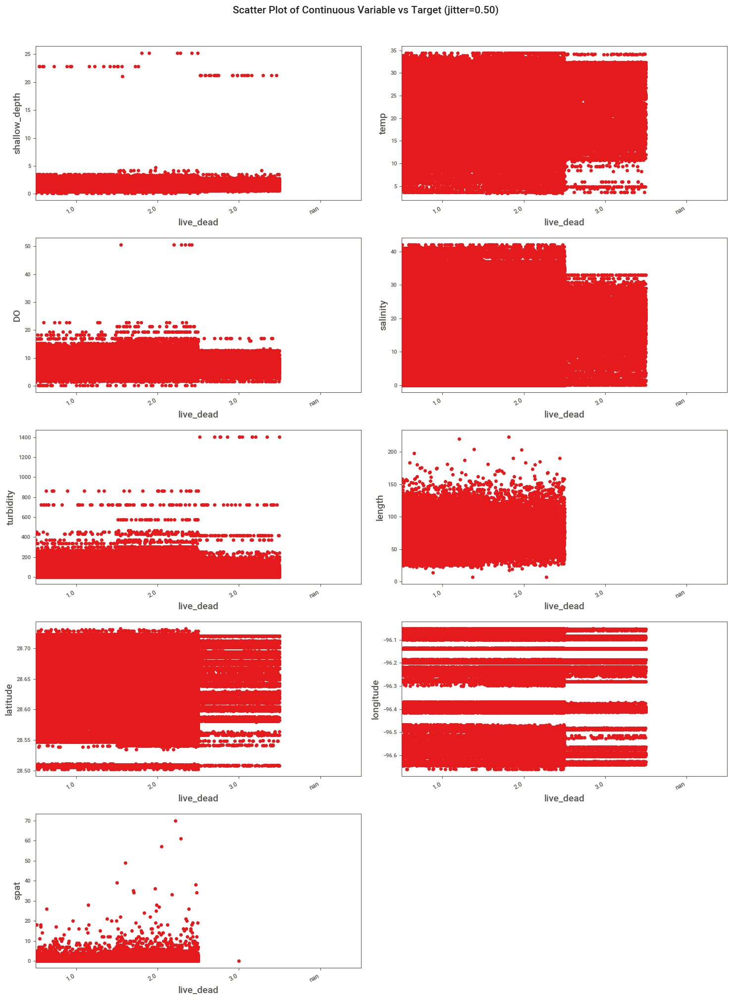

Total Number of Scatter Plots = 45


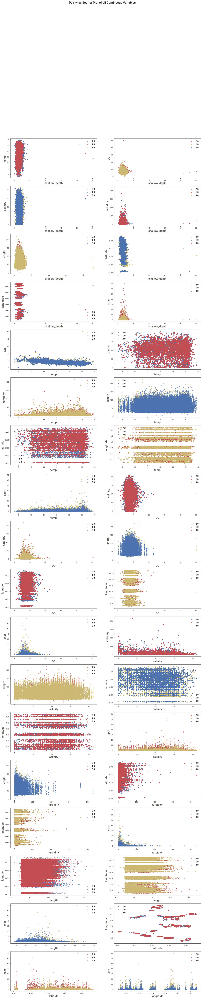

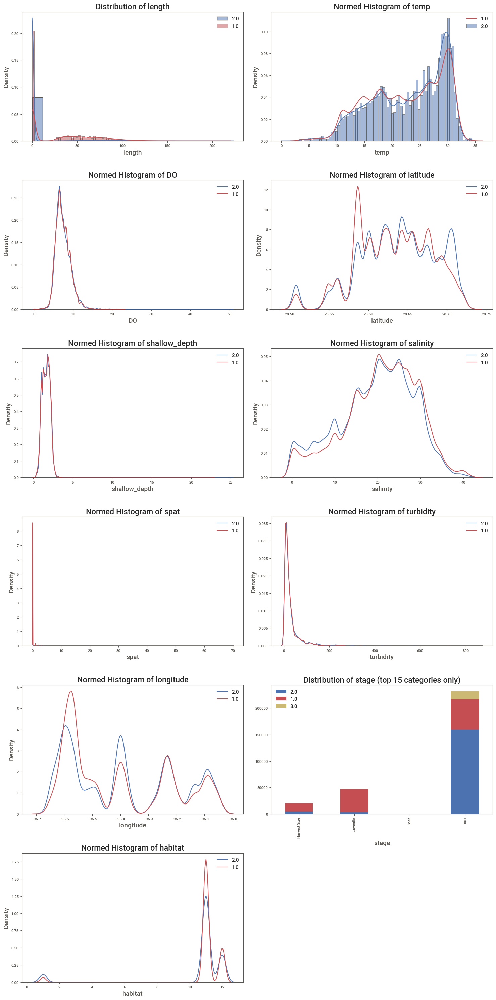

Could not draw some Distribution Plots


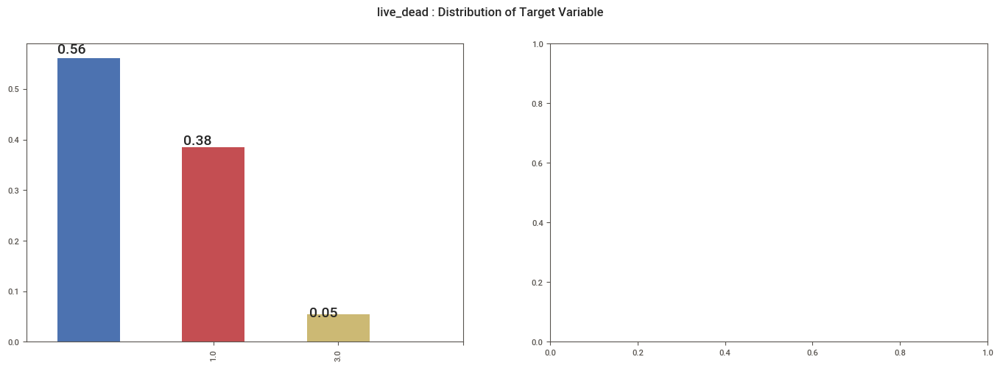

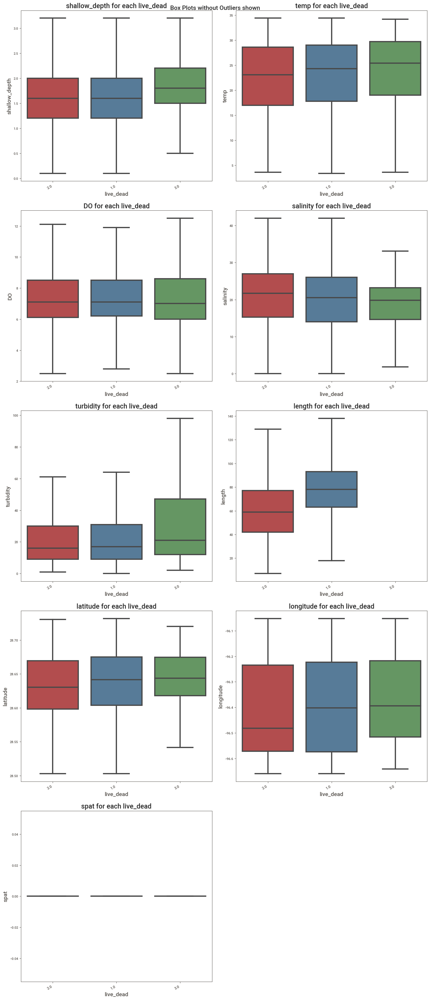

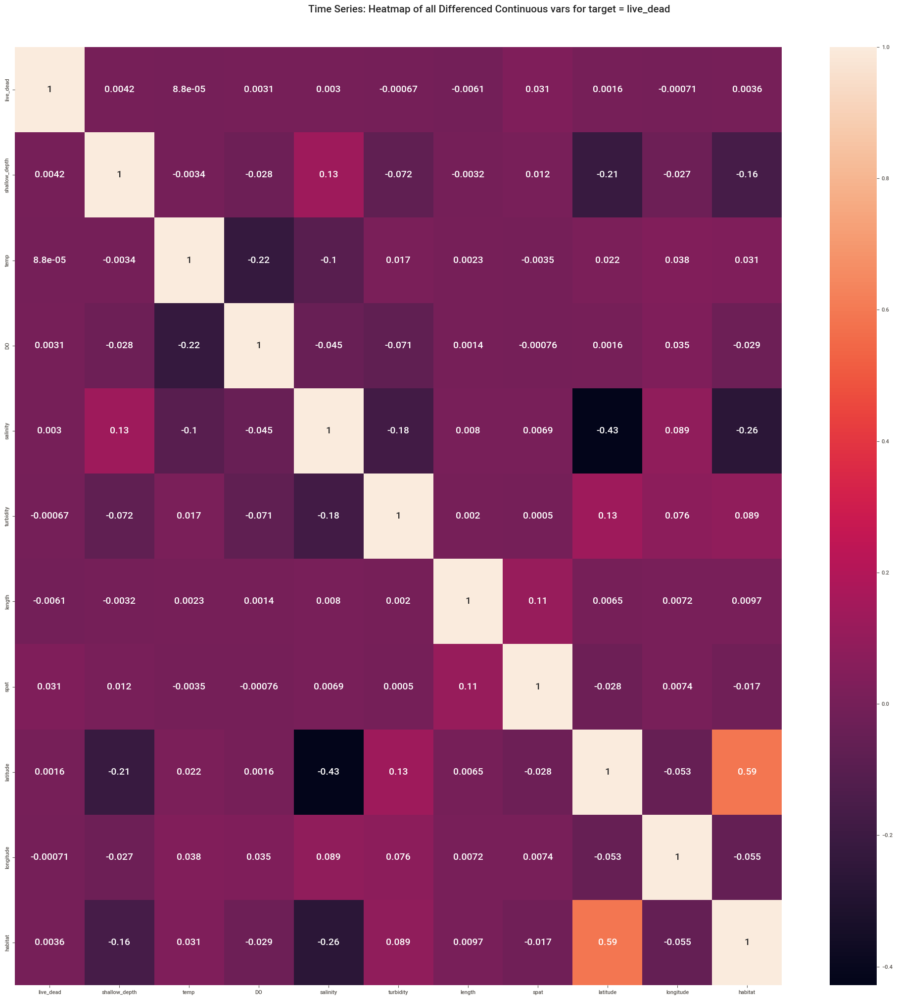

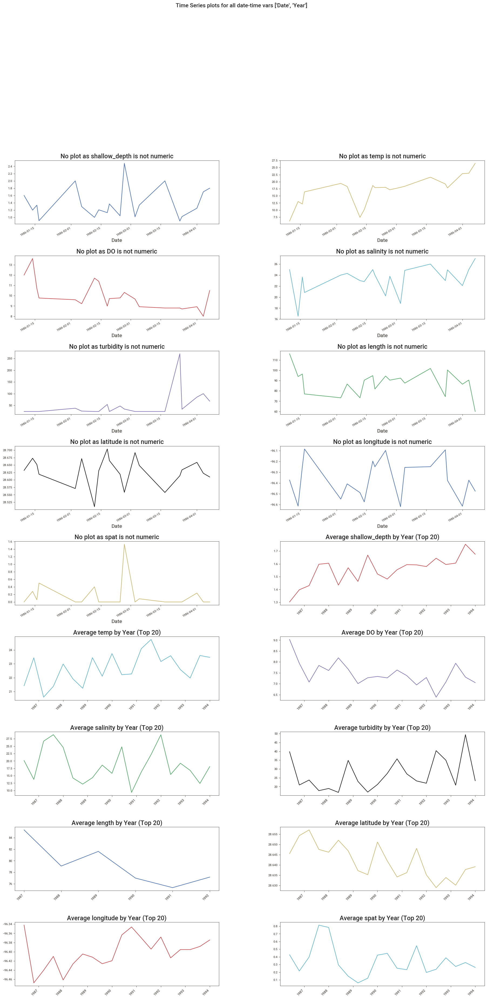

Could not draw some Time Series plots


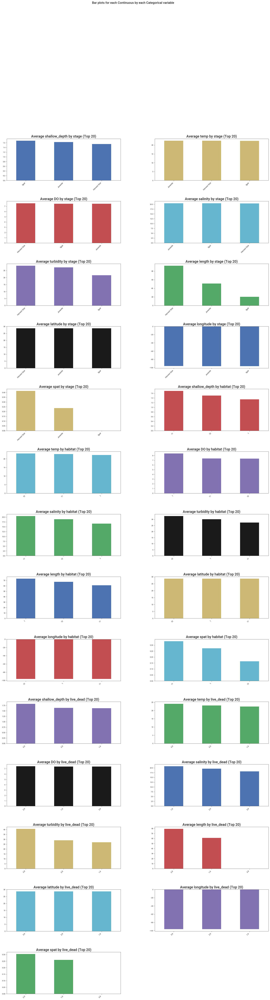

All Plots done
Time to run AutoViz = 143 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
AutoViz executed in 2.3838637471199036 minutes.
*********************************************
Starting Harvest Analysis...


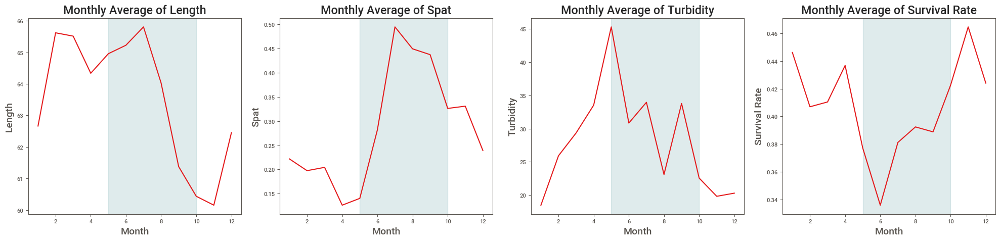

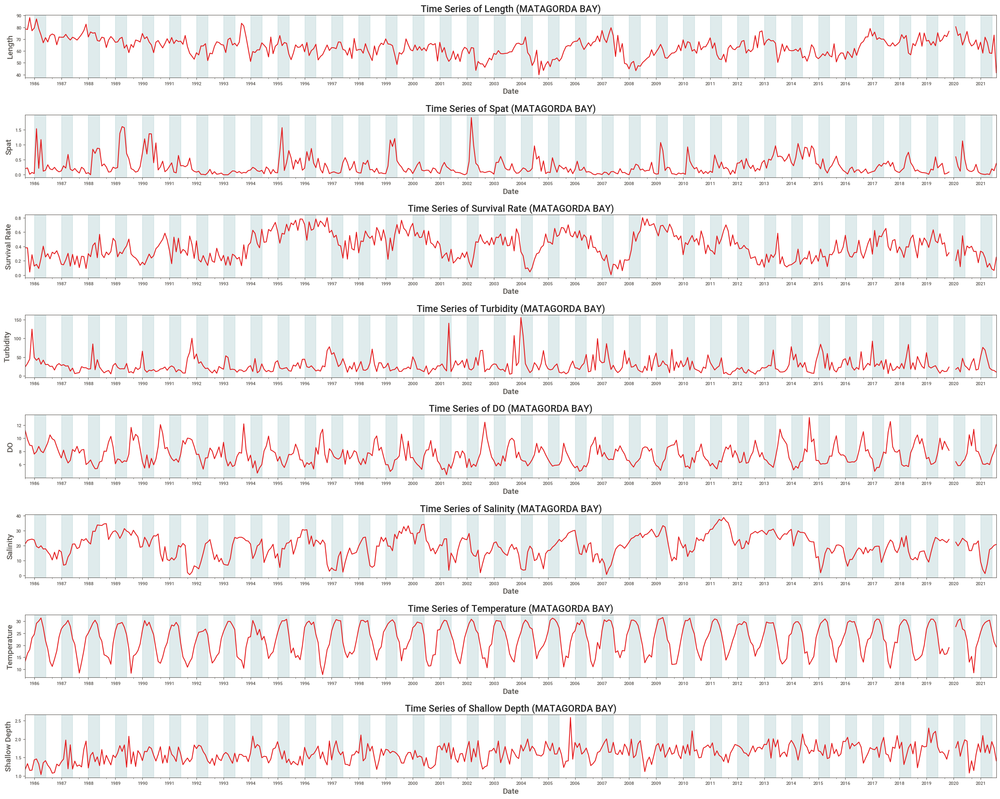

*********************************************
Done!


In [23]:
main('MATAGORDA BAY')

## 3.5 SABINE LAKE

*********************************************
Dataset Info:
Shape of the dataset: (105206, 17)
Percentage of missing values column-wise:
major_area_code_text     0.000000
shallow_depth            0.043724
temp                     0.000000
DO                       0.000000
salinity                 0.000000
turbidity                0.662510
length                  70.893295
stage                   70.893295
live_dead                0.000951
spat                    80.369941
latitude                 0.000000
longitude                0.000000
Date                     0.000000
Year                     0.000000
length_code             90.941581
habitat                  0.000000
HYDRO_ID                86.815391
dtype: float64
*********************************************
Starting ydata Profile...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

ydata Profile for SABINE LAKE executed in 0.6640547593434651 minutes.
*********************************************
Starting Sweetviz Analysis...


                                             |          | [  0%]   00:00 -> (? left)

Report SABINE LAKE_target_analysis_report_live_dead.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.
Sweetviz target analysis executed in 0.2729536175727844 minutes.
*********************************************
Starting AutoViz Analysis...
Shape of your Data Set loaded: (105206, 17)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    16 Predictors classified...
        2 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['major_area_code_text', 'length_code']

################ Multi_Classification problem #####################
To fix data quality issues automatically, import FixDQ from autoviz...
  

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
shallow_depth,float64,0.057197,NA,0.000000,7.600000,"20 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 3001 outliers greater than upper bound (3.30) or lower than lower bound(0.90). Cap them or remove them."
temp,float64,0.000000,NA,2.300000,32.600000,No issue
DO,float64,0.000000,NA,2.000000,16.800000,"has 259 outliers greater than upper bound (13.00) or lower than lower bound(1.80). Cap them or remove them., has a high correlation with ['temp']. Consider dropping one of them."
salinity,float64,0.000000,NA,0.000000,30.000000,No issue
turbidity,float64,0.560528,NA,1.000000,173.000000,"196 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1635 outliers greater than upper bound (49.00) or lower than lower bound(-15.00). Cap them or remove them."
length,float64,15.832070,NA,7.000000,215.000000,"5536 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 131 outliers greater than upper bound (147.50) or lower than lower bound(-0.50). Cap them or remove them."
stage,object,15.832070,0,nan,nan,"5536 missing values. Impute them with mean, median, mode, or a constant value such as 123., 1 rare categories: ['Spat']. Group them into a single category or drop the categories., Mixed dtypes: has 2 different data types: object, float,"
spat,float64,58.526611,NA,0.000000,14.000000,"20465 missing values. Impute them with mean, median, mode, or a constant value such as 123., has 1732 outliers greater than upper bound (0.00) or lower than lower bound(0.00). Cap them or remove them."
latitude,float64,0.000000,NA,27.786400,29.803900,has 1987 outliers greater than upper bound (29.80) or lower than lower bound(29.77). Cap them or remove them.
longitude,float64,0.000000,NA,-93.955556,-93.854167,has 1715 outliers greater than upper bound (-93.89) or lower than lower bound(-93.94). Cap them or remove them.


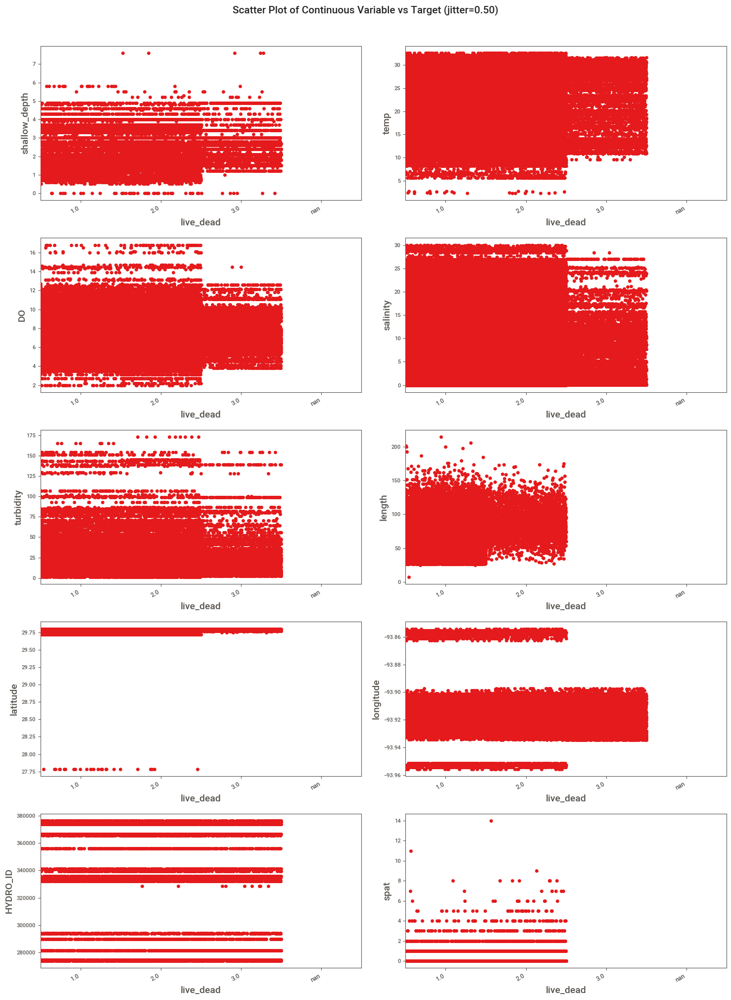

Total Number of Scatter Plots = 55


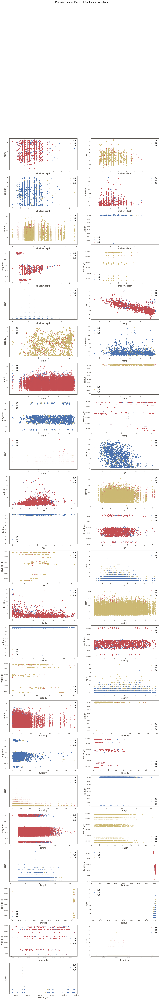

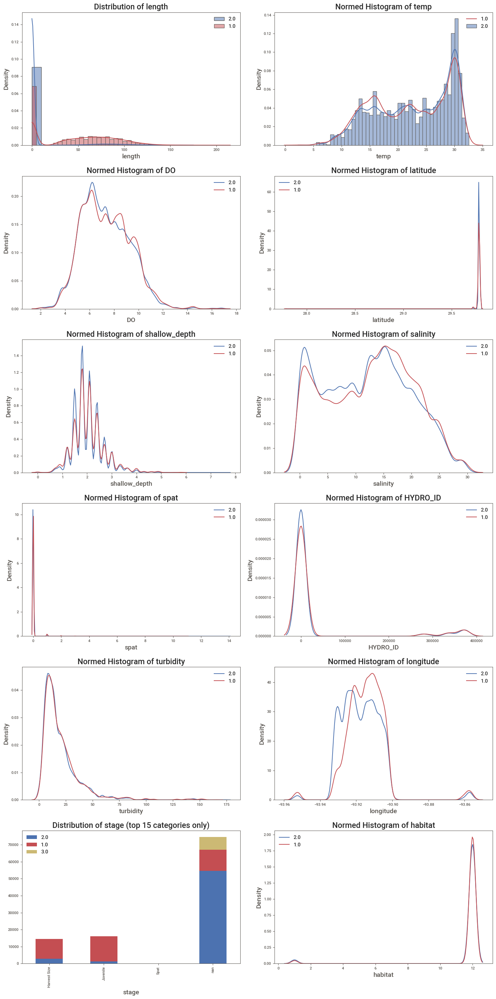

Could not draw some Distribution Plots


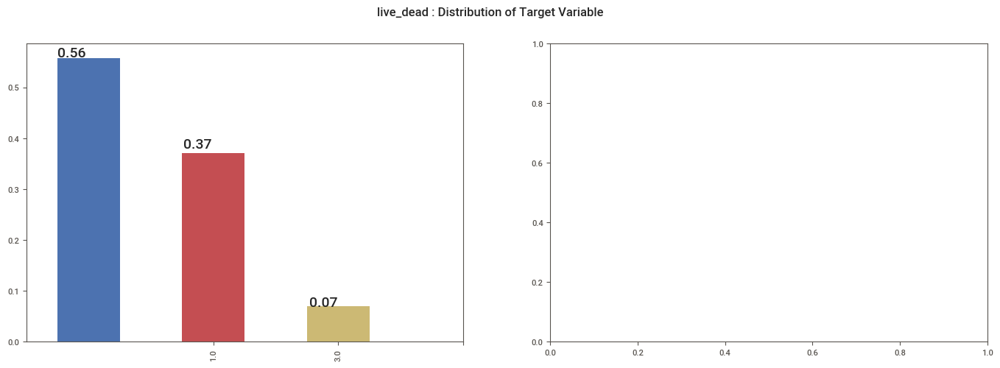

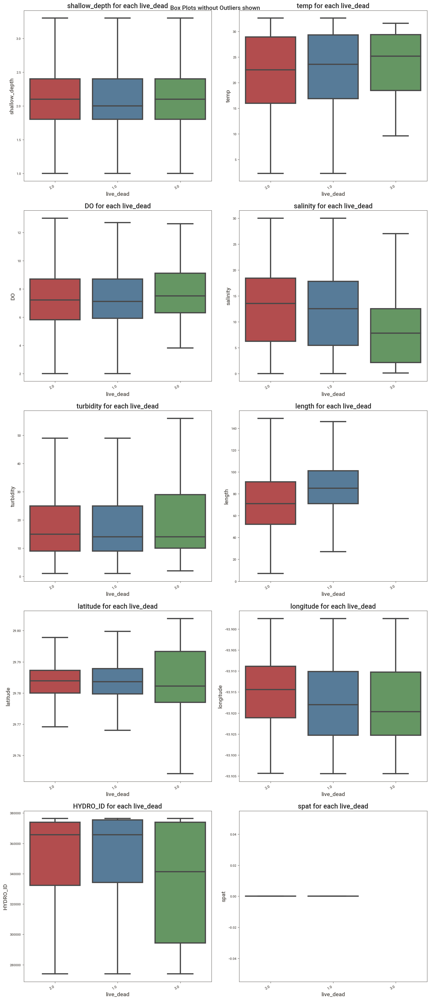

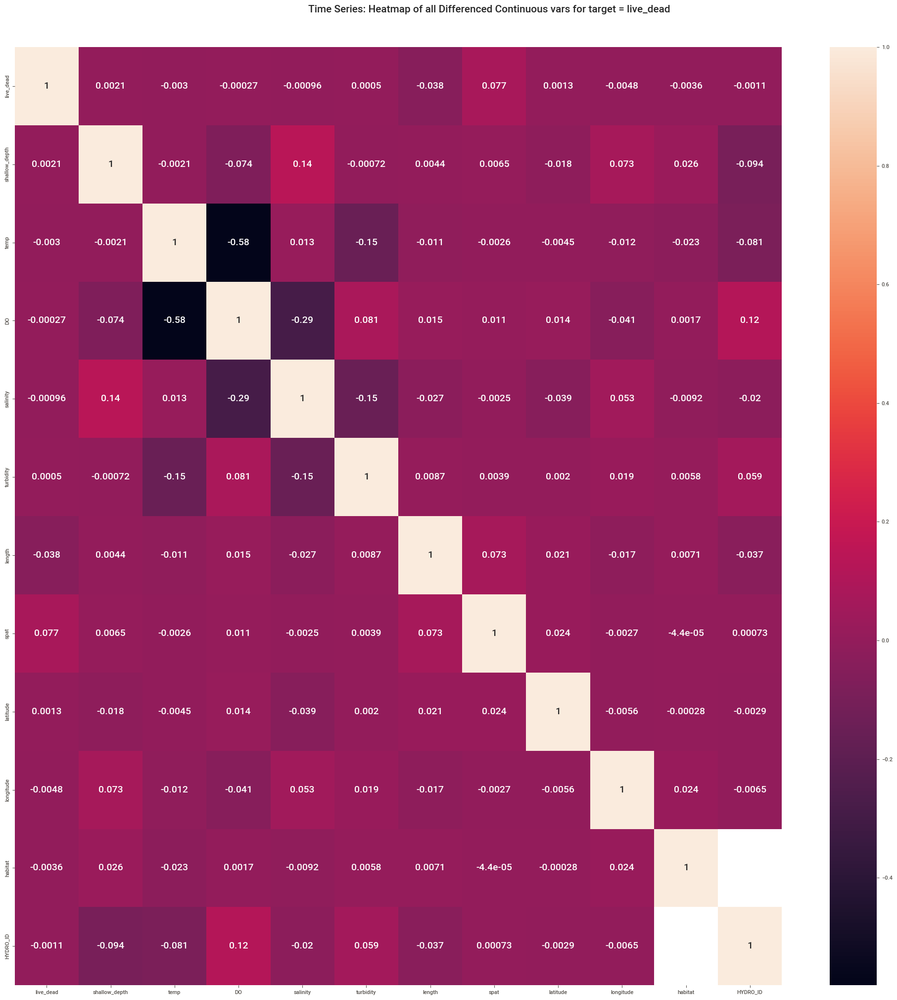

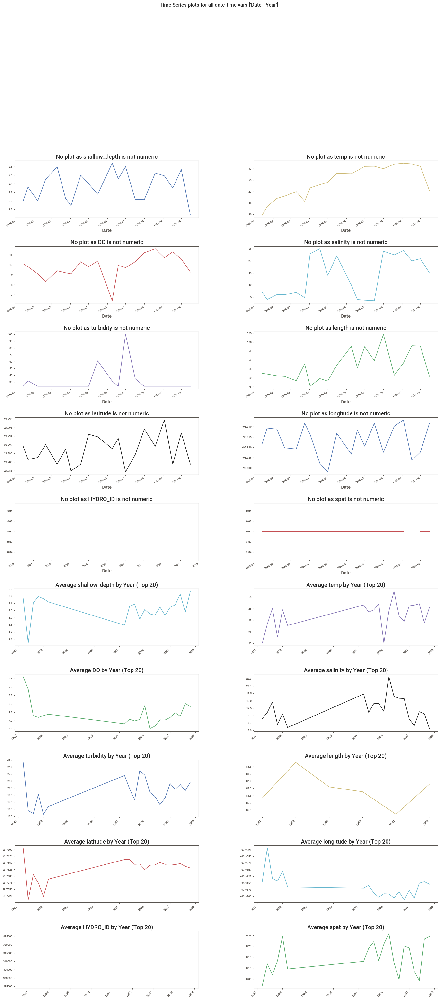

Could not draw some Time Series plots


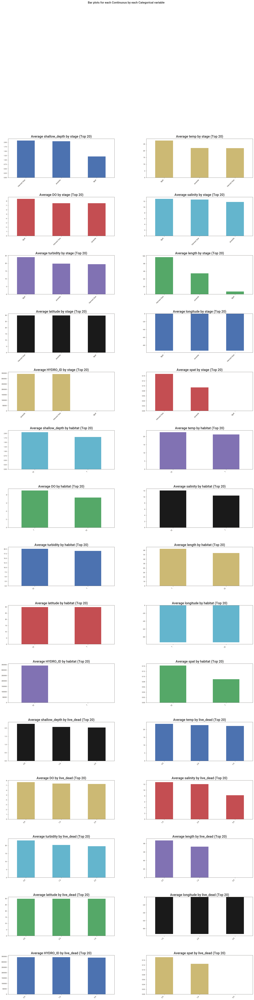

All Plots done
Time to run AutoViz = 83 seconds 

 ###################### AUTO VISUALIZATION Completed ########################
AutoViz executed in 1.378937808672587 minutes.
*********************************************
Starting Harvest Analysis...


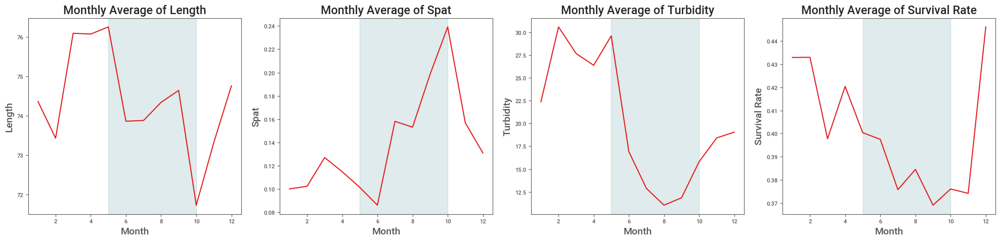

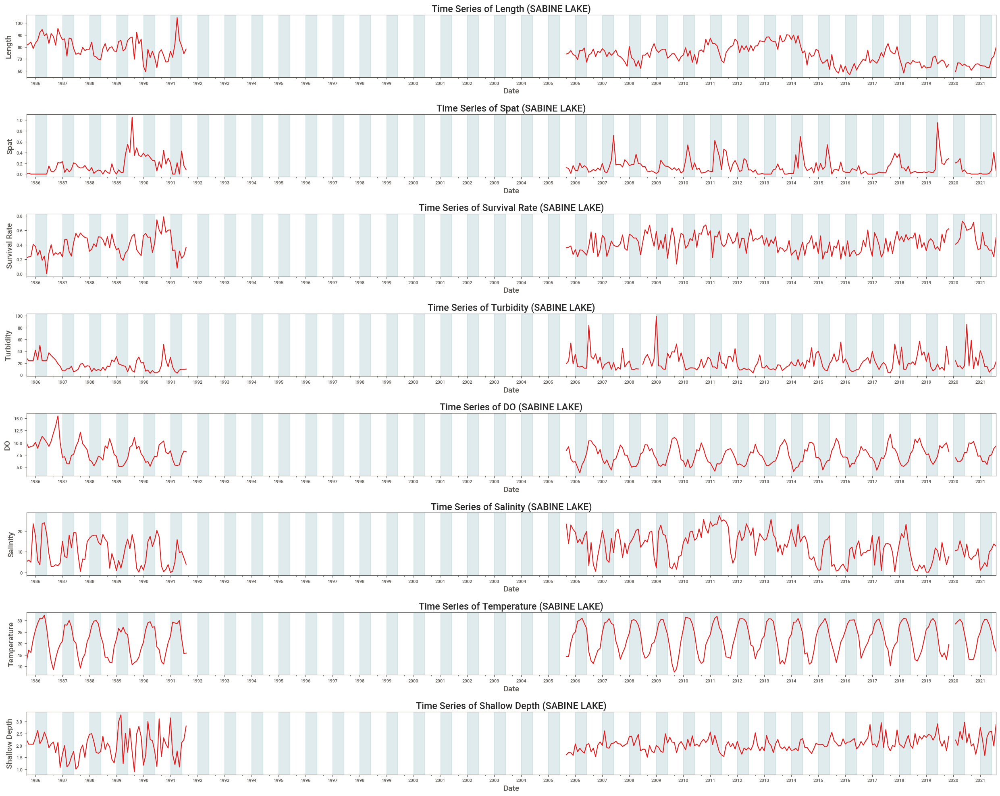

*********************************************
Done!


In [24]:
main('SABINE LAKE')